## Torchvision

In [1]:
import torchvision
from torchvision.models import list_models

list_models(module=torchvision.models)

['alexnet',
 'convnext_base',
 'convnext_large',
 'convnext_small',
 'convnext_tiny',
 'densenet121',
 'densenet161',
 'densenet169',
 'densenet201',
 'efficientnet_b0',
 'efficientnet_b1',
 'efficientnet_b2',
 'efficientnet_b3',
 'efficientnet_b4',
 'efficientnet_b5',
 'efficientnet_b6',
 'efficientnet_b7',
 'efficientnet_v2_l',
 'efficientnet_v2_m',
 'efficientnet_v2_s',
 'googlenet',
 'inception_v3',
 'maxvit_t',
 'mnasnet0_5',
 'mnasnet0_75',
 'mnasnet1_0',
 'mnasnet1_3',
 'mobilenet_v2',
 'mobilenet_v3_large',
 'mobilenet_v3_small',
 'regnet_x_16gf',
 'regnet_x_1_6gf',
 'regnet_x_32gf',
 'regnet_x_3_2gf',
 'regnet_x_400mf',
 'regnet_x_800mf',
 'regnet_x_8gf',
 'regnet_y_128gf',
 'regnet_y_16gf',
 'regnet_y_1_6gf',
 'regnet_y_32gf',
 'regnet_y_3_2gf',
 'regnet_y_400mf',
 'regnet_y_800mf',
 'regnet_y_8gf',
 'resnet101',
 'resnet152',
 'resnet18',
 'resnet34',
 'resnet50',
 'resnext101_32x8d',
 'resnext101_64x4d',
 'resnext50_32x4d',
 'shufflenet_v2_x0_5',
 'shufflenet_v2_x1_0',
 'sh

In [2]:
model = torchvision.models.alexnet(weights="IMAGENET1K_V1")
model

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

## Uso de Timm

In [3]:
import timm

timm.list_models()
timm.list_models("resnet*")
resnet = timm.create_model("resnet18", pretrained=True)
resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (drop_block): Identity()
      (act1): ReLU(inplace=True)
      (aa): Identity()
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act2): ReLU(inplace=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, m

## Get Activations from a specific Layer

In [4]:
import torch
import torch.nn as nn

torch.manual_seed(0)
torch.cuda.manual_seed(0)


def hook_fn(model, input, output):
    print(output.shape)


model = torchvision.models.alexnet(weights="IMAGENET1K_V1")
model.features[1].register_forward_hook(hook_fn)

a = torch.zeros(1, 3, 224, 256)
model.eval()
with torch.no_grad():
    model(a)

torch.Size([1, 64, 55, 63])


In [5]:
resnet.layer1[0].conv1.register_forward_hook(hook_fn)
a = torch.zeros(1, 3, 224, 256)
resnet.eval()
with torch.no_grad():
    resnet(a)

torch.Size([1, 64, 56, 64])


## Transfer Learning

In [6]:
from torchvision.datasets import ImageFolder
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import torchmetrics
import time
from torchinfo import summary


class Transforms:
    def __init__(self, transform: A.Compose):
        self.transform = transform

    def __call__(self, image):
        image = np.array(image)
        return self.transform(image=image)["image"]


train_transforms = A.Compose(
    [A.Resize(256, 256), A.ToFloat(), ToTensorV2()]
)
validation_transforms = A.Compose(
    [A.Resize(256, 256), A.ToFloat(), ToTensorV2()]
)

In [7]:
train_data = ImageFolder(
    "CATS_DOGS/train",
    transform=Transforms(train_transforms),
)
validation_data = ImageFolder(
    "CATS_DOGS/validation",
    transform=Transforms(validation_transforms),
)

print(f"Elementos en Entrenamiento: {len(train_data)}")
print(f"Elementos en Validación: {len(validation_data)}")

Elementos en Entrenamiento: 18743
Elementos en Validación: 6251


In [8]:
idx_to_class_dict = {v: k for k, v in train_data.class_to_idx.items()}
idx_to_class_dict

{0: 'CAT', 1: 'DOG'}

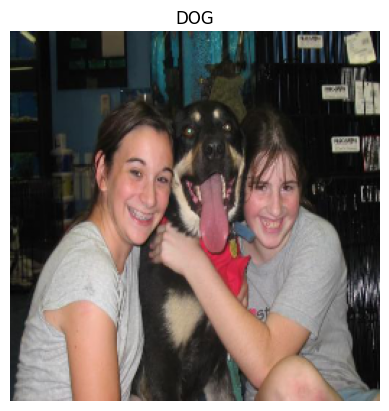

In [9]:
idx = np.random.randint(0, len(train_data))


## Es importante cambiar el orden de los canales para poder mostrar la imagen...
def plot_images(idx, data):
    plt.imshow(data[idx][0].permute(1, 2, 0))
    class_label = data[idx][1]
    plt.title(data.classes[class_label])
    plt.axis("off")


plot_images(idx, train_data)

In [10]:
torchvision.models.alexnet(weights="IMAGENET1K_V1")

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [11]:
class CNN(nn.Module):
    def __init__(self, in_channels=3, n_outputs=1, ks=3):
        super().__init__()
        self.conv1 = self.CNN_block(in_channels, 32, k=ks)
        self.conv2 = self.CNN_block(32, 16, k=ks)
        self.conv3 = self.CNN_block(16, 8, k=ks)
        self.flatten = nn.Flatten()
        self.fc1 = nn.LazyLinear(4096)
        # self.fc1 = nn.Linear(32 * 5 * 5, 16)  # filtros x tamaño
        self.fc2 = nn.Linear(4096, n_outputs)

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.flatten(x)
        x = self.fc1(x)
        x = self.fc2(x)
        return x

    @staticmethod
    def CNN_block(c_in, c_out, k=3, p=0, s=1, pk=2, ps=2):
        return nn.Sequential(
            nn.Conv2d(
                in_channels=c_in,
                out_channels=c_out,
                kernel_size=k,
                padding=p,
                stride=s,
            ),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=pk, stride=ps),
        )

In [12]:
class Alexnet(nn.Module):
    def __init__(self, backbone, output_dim, frozen=False):
        super().__init__()
        self.backbone = backbone
        # Modificar la Prediction Head para que permite Clasificación Binaria
        self.backbone.classifier[6] = nn.LazyLinear(output_dim)

        if frozen:
            self.backbone.features.requires_grad_(False)

    def forward(self, x):
        x = self.backbone(x)
        return x

In [13]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# device = torch.device("cpu")


def train_model(
    train_data,
    val_data,
    model,
    training_params,
    criterion=nn.CrossEntropyLoss(),
):
    print(f"Making {torch.cuda.get_device_name(0)} go brrruuummmmm....")
    model.to(device)
    optimizer = torch.optim.Adam(
        model.parameters(),
        lr=training_params["learning_rate"],
    )

    train_dataloader = DataLoader(
        train_data,
        batch_size=training_params["batch_size"],
        shuffle=True,
        num_workers=12,
        pin_memory=True,
    )
    val_dataloader = DataLoader(
        val_data,
        batch_size=training_params["batch_size"],
        shuffle=False,
        num_workers=12,
        pin_memory=True,
    )

    train_metric = torchmetrics.Precision(task="binary").to(device)
    val_metric = torchmetrics.Precision(task="binary").to(device)

    train_loss = []
    val_loss = []
    for e in range(training_params["num_epochs"]):
        start_time = time.time()
        train_batch_loss = []
        val_batch_loss = []
        model.train()
        for batch in train_dataloader:
            X, y = batch
            X, y = X.to(device), y.float().unsqueeze(1).to(device)

            optimizer.zero_grad()
            y_hat = model(X)
            loss = criterion(y_hat, y)
            loss.backward()
            optimizer.step()
            tr_acc = train_metric(y_hat, y)
            train_batch_loss.append(loss.item())

        tr_acc = train_metric.compute()
        train_epoch_loss = np.mean(train_batch_loss)

        model.eval()
        with torch.no_grad():
            for batch in val_dataloader:
                X, y = batch
                X, y = X.to(device), y.float().unsqueeze(1).to(device)

                y_hat = model(X)
                loss = criterion(y_hat, y)
                val_acc = val_metric(y_hat, y)
                val_batch_loss.append(loss.item())

        val_acc = val_metric.compute()
        val_epoch_loss = np.mean(val_batch_loss)

        end_time = time.time()
        elapsed_time = end_time - start_time
        print(
            f"Epoch: {e+1}: Time: {elapsed_time:.2f} - Train Loss: {train_epoch_loss:.4f} - Validation Loss: {val_epoch_loss:.4f} - Train Precision: {tr_acc:.4f} - Validation Precision: {val_acc:.4f}"
        )
        train_loss.append(train_epoch_loss)
        val_loss.append(val_epoch_loss)

    return model, train_loss, val_loss

In [14]:
training_params = dict(
    learning_rate=3e-4,
    batch_size=64,
    num_epochs=3,
)
vanilla_model = CNN(in_channels=3, n_outputs=1).to(device)

summary(vanilla_model, input_size=(1, 3, 256, 256))
vanilla_model, train_loss, val_loss = train_model(
    train_data,
    validation_data,
    model=vanilla_model,
    training_params=training_params,
    criterion=nn.BCEWithLogitsLoss(),
)

Making NVIDIA GeForce RTX 2070 with Max-Q Design go brrruuummmmm....


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 1: Time: 29.79 - Train Loss: 0.6193 - Validation Loss: 0.5873 - Train Precision: 0.6597 - Validation Precision: 0.6417


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 2: Time: 29.50 - Train Loss: 0.5367 - Validation Loss: 0.5333 - Train Precision: 0.7024 - Validation Precision: 0.6802


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 3: Time: 29.53 - Train Loss: 0.5078 - Validation Loss: 0.5422 - Train Precision: 0.7215 - Validation Precision: 0.7048


In [15]:
training_params = dict(
    learning_rate=3e-4,
    batch_size=256,
    num_epochs=3,
)
frozen_alexnet = Alexnet(
    backbone=torchvision.models.alexnet(weights="IMAGENET1K_V1"),
    output_dim=1,
    frozen=True,
).to(device)

summary(frozen_alexnet, input_size=(1, 3, 256, 256))
frozen_alexnet, train_loss, val_loss = train_model(
    train_data,
    validation_data,
    model=frozen_alexnet,
    training_params=training_params,
    criterion=nn.BCEWithLogitsLoss(),
)

Making NVIDIA GeForce RTX 2070 with Max-Q Design go brrruuummmmm....


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 1: Time: 19.73 - Train Loss: 0.2238 - Validation Loss: 0.1595 - Train Precision: 0.9035 - Validation Precision: 0.9540


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 2: Time: 18.75 - Train Loss: 0.1469 - Validation Loss: 0.1491 - Train Precision: 0.9222 - Validation Precision: 0.9386


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 3: Time: 18.94 - Train Loss: 0.1325 - Validation Loss: 0.1455 - Train Precision: 0.9304 - Validation Precision: 0.9454


In [16]:
training_params = dict(
    learning_rate=3e-4,
    batch_size=256,
    num_epochs=3,
)
ft_alexnet = Alexnet(
    backbone=torchvision.models.alexnet(weights="IMAGENET1K_V1"),
    output_dim=1,
    frozen=False,
).to(device)

summary(ft_alexnet, input_size=(1, 3, 256, 256))
ft_alexnet, train_loss, val_loss = train_model(
    train_data,
    validation_data,
    model=ft_alexnet,
    training_params=training_params,
    criterion=nn.BCEWithLogitsLoss(),
)

Making NVIDIA GeForce RTX 2070 with Max-Q Design go brrruuummmmm....


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 1: Time: 26.80 - Train Loss: 0.4401 - Validation Loss: 0.2596 - Train Precision: 0.7869 - Validation Precision: 0.8431


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 2: Time: 26.89 - Train Loss: 0.1542 - Validation Loss: 0.1115 - Train Precision: 0.8657 - Validation Precision: 0.8924


/home/datacuber/miniconda3/lib/python3.12/site-packages/PIL/TiffImagePlugin.py:900: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Epoch: 3: Time: 27.41 - Train Loss: 0.0844 - Validation Loss: 0.1038 - Train Precision: 0.8995 - Validation Precision: 0.9161


In [17]:
from mpl_toolkits.axes_grid1 import ImageGrid
from pathlib import Path


def predict(model, image, transform):
    image = np.array(Image.open(image))
    pic = transform(image=image)["image"]

    model.eval()
    with torch.no_grad():
        new_prediction = model(pic.view(1, 3, 256, 256).to(device))

    new_prediction = torch.where(new_prediction > 0, 1, 0).item()

    return idx_to_class_dict[new_prediction]


def prediction_grid(model, image_list, transform, grid_size=(20, 40)):

    fig = plt.figure(1, grid_size)
    grid = ImageGrid(
        fig,
        111,
        nrows_ncols=(2, 4),
        axes_pad=0.4,
    )

    for img, axes in zip(image_list, grid):

        image_name = Path(img).name
        axes.set_title(
            f"{image_name} predicted as {predict(model, img, transform)}",
            fontdict=None,
            loc="center",
            color="k",
            fontsize=20,
        )
        axes.axis("off")
        axes.imshow(Image.open(img))

    return plt.show()

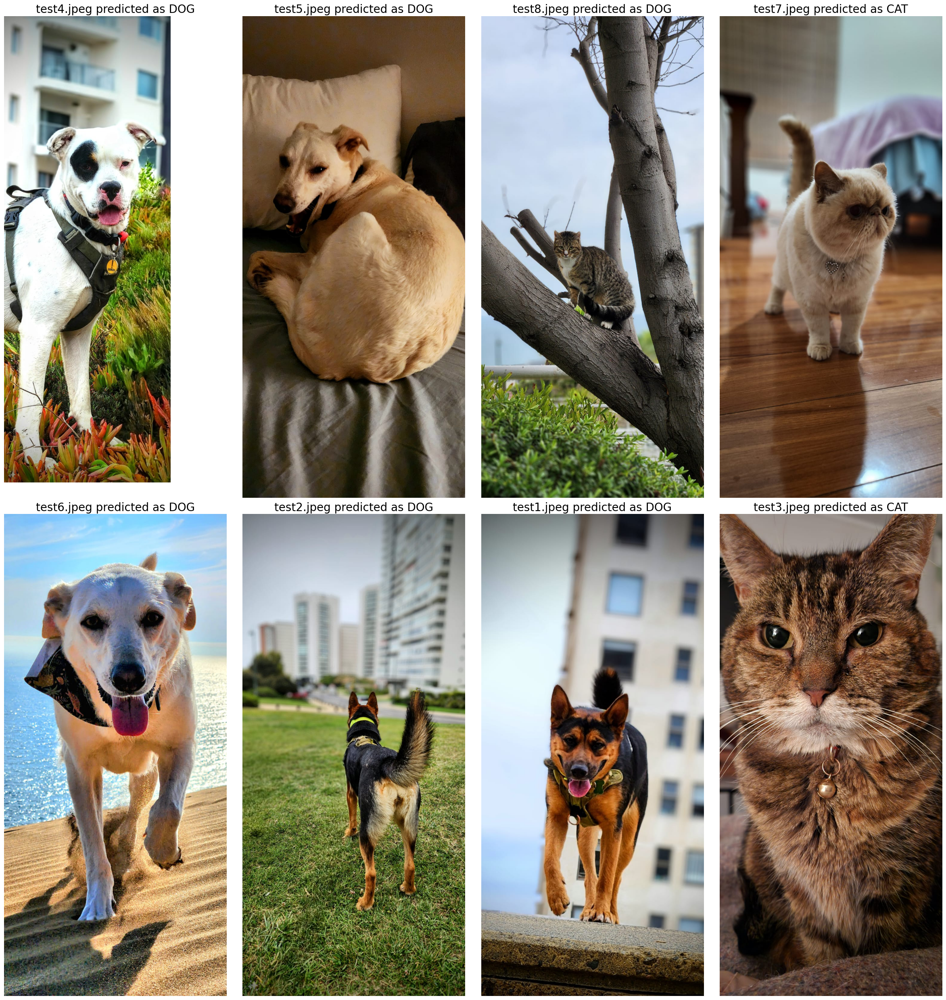

In [18]:
import glob

images = glob.glob("CATS_DOGS/test/*")

test_transform = A.Compose([A.Resize(256, 256), A.ToFloat(), ToTensorV2()])
prediction_grid(
    vanilla_model,
    reversed(images),
    transform=test_transform,
    grid_size=(30, 70),
)

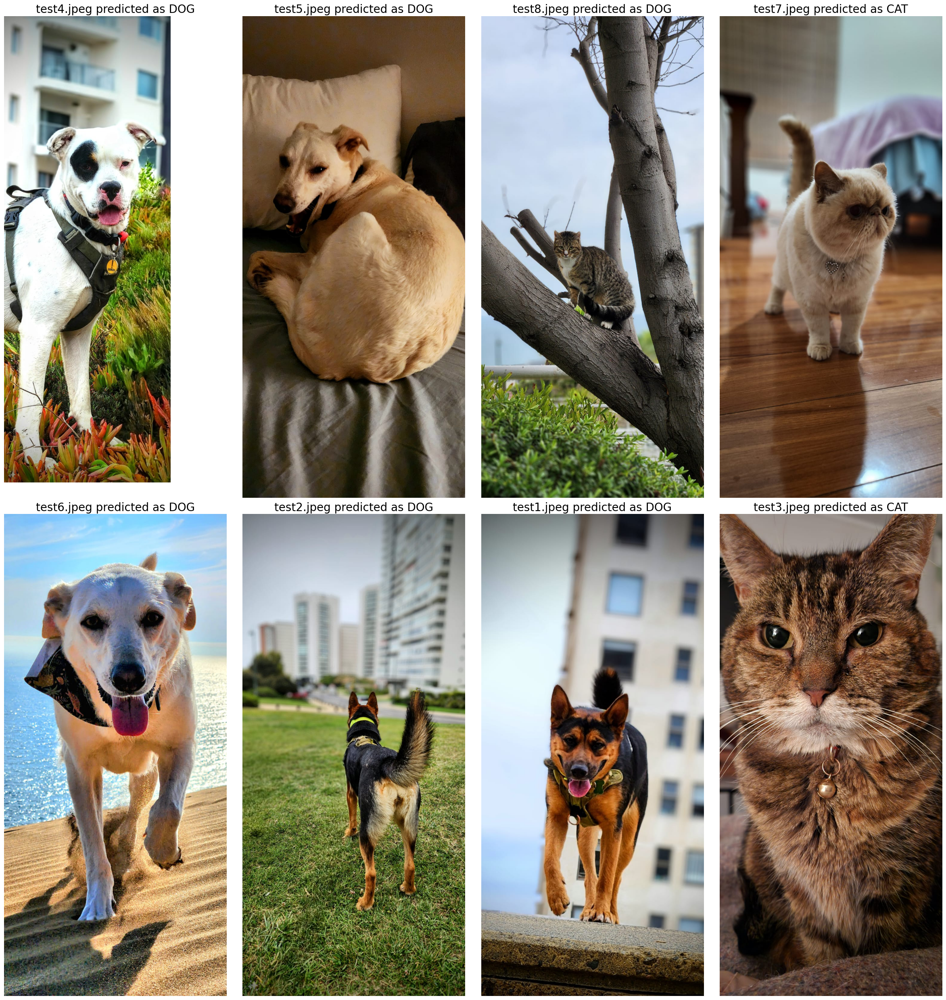

In [19]:
prediction_grid(
    frozen_alexnet,
    reversed(images),
    transform=test_transform,
    grid_size=(30, 70),
)

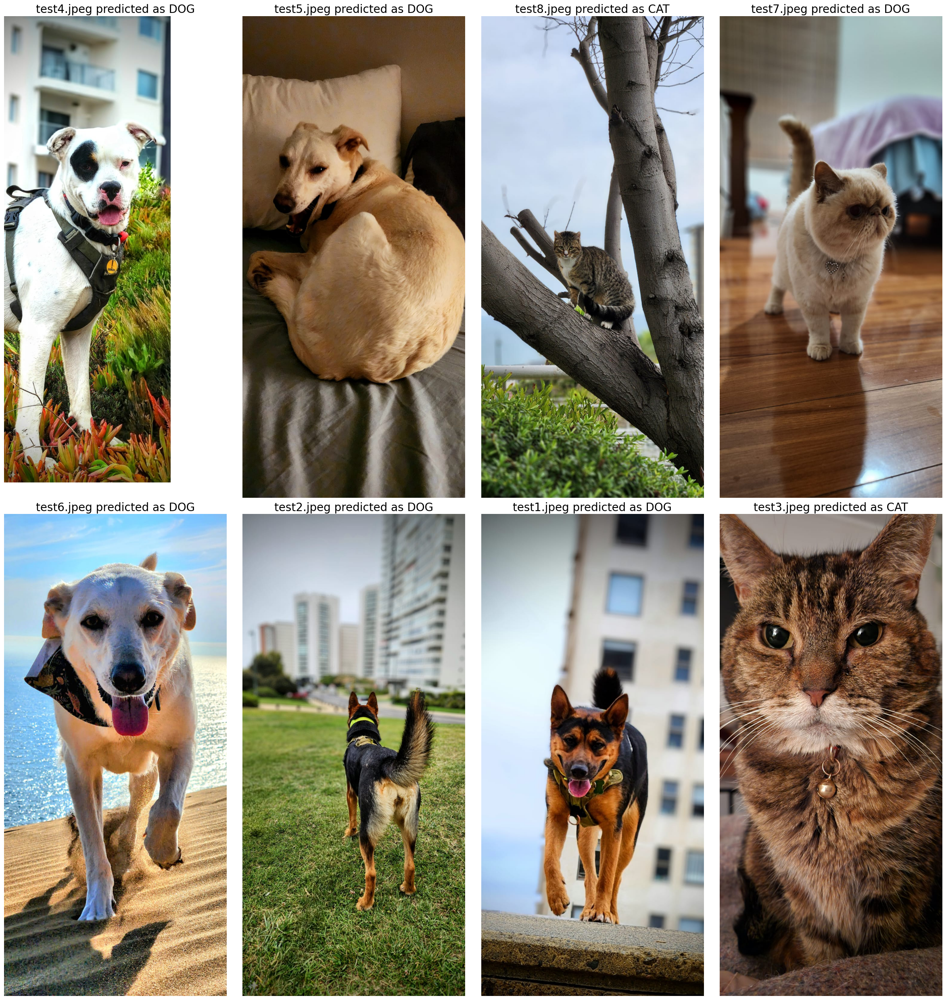

In [20]:
prediction_grid(
    ft_alexnet,
    reversed(images),
    transform=test_transform,
    grid_size=(30, 70),
)